<a href="https://colab.research.google.com/github/Shantanu909/MobilTelesco/blob/main/MBTr_FRCNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Detectron2 Beginner's Tutorial

<img src="https://dl.fbaipublicfiles.com/detectron2/Detectron2-Logo-Horz.png" width="500">

Welcome to detectron2! This is the official colab tutorial of detectron2. Here, we will go through some basics usage of detectron2, including the following:
* Run inference on images or videos, with an existing detectron2 model
* Train a detectron2 model on a new dataset

You can make a copy of this tutorial by "File -> Open in playground mode" and make changes there. __DO NOT__ request access to this tutorial.


# Install detectron2

In [7]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Using cached PyYAML-5.1.tar.gz (274 kB)
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
fatal: destination path 'detectron2' already exists and is not an empty directory.
Ignoring dataclasses: markers 'python_version < "3.7"' don't match your environment


In [8]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2024 NVIDIA Corporation
Built on Thu_Jun__6_02:18:23_PDT_2024
Cuda compilation tools, release 12.5, V12.5.82
Build cuda_12.5.r12.5/compiler.34385749_0
torch:  2.5 ; cuda:  cu124
detectron2: 0.6


In [10]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

# Train on a custom dataset

In this section, we show how to train an existing detectron2 model on a custom dataset in a new format.

We use [the balloon segmentation dataset](https://github.com/matterport/Mask_RCNN/tree/master/samples/balloon)
which only has one class: balloon.
We'll train a balloon segmentation model from an existing model pre-trained on COCO dataset, available in detectron2's model zoo.

Note that COCO dataset does not have the "balloon" category. We'll be able to recognize this new class in a few minutes.

## Prepare the dataset

In [11]:
# download, decompress the data
!unzip /content/MBTr1.zip -d /content/MBTr1

Archive:  /content/MBTr1.zip
   creating: /content/MBTr1/MBTr1/
   creating: /content/MBTr1/MBTr1/test/
  inflating: /content/MBTr1/MBTr1/test/IMG20250118233355_BURST021.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250117235554_BURST009.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250121220603_BURST005.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250117235554_BURST038.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250104213759_BURST026.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250121220603_BURST031.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250105224134_BURST021.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250118230637_BURST044.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250119214045_BURST009.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250121224118_BURST043.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250117232801_BURST016.jpg  
  inflating: /content/MBTr1/MBTr1/test/IMG20250119205411_BURST043.jpg  
  inflating: /content/MBTr1/MBTr

Register the balloon dataset to detectron2, following the [detectron2 custom dataset tutorial](https://detectron2.readthedocs.io/tutorials/datasets.html).
Here, the dataset is in its custom format, therefore we write a function to parse it and prepare it into detectron2's standard format. User should write such a function when using a dataset in custom format. See the tutorial for more details.


In [24]:
from detectron2.data import DatasetCatalog, MetadataCatalog

# Remove old registration to avoid conflicts
DatasetCatalog.remove("mbtr1_train")
MetadataCatalog.remove("mbtr1_train")
DatasetCatalog.remove("mbtr1_val")
MetadataCatalog.remove("mbtr1_val")
DatasetCatalog.remove("mbtr1_test")
MetadataCatalog.remove("mbtr1_test")

KeyError: 'mbtr1_test'

In [26]:
from detectron2.data.datasets import register_coco_instances

# Corrected paths
register_coco_instances("mbtr1_train", {}, "/content/MBTr1/MBTr1/train/annotations.json", "/content/MBTr1/MBTr1/train")
register_coco_instances("mbtr1_val", {}, "/content/MBTr1/MBTr1/val/annotations.json", "/content/MBTr1/MBTr1/val")
register_coco_instances("mbtr1_test", {}, "/content/MBTr1/MBTr1/test/annotations.json", "/content/MBTr1/MBTr1/test")

# Get metadata
mbtr1_metadata = MetadataCatalog.get("mbtr1_train")


To verify the dataset is in correct format, let's visualize the annotations of randomly selected samples in the training set:



[02/28 23:24:20 d2.data.datasets.coco]: Loaded 623 images in COCO format from /content/MBTr1/MBTr1/train/annotations.json


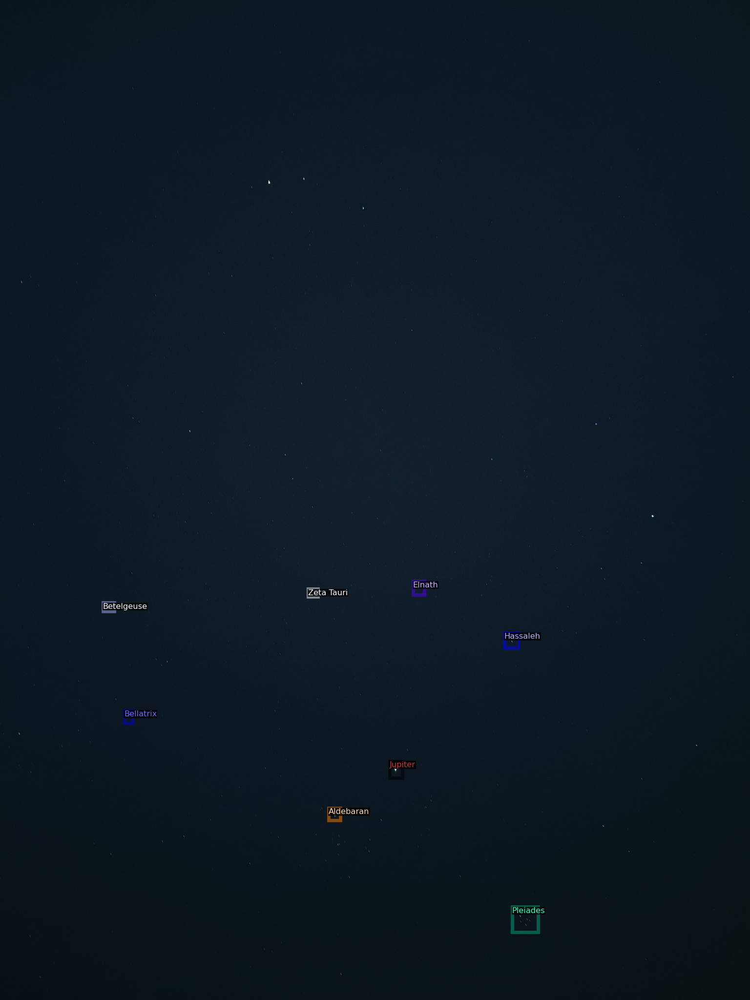

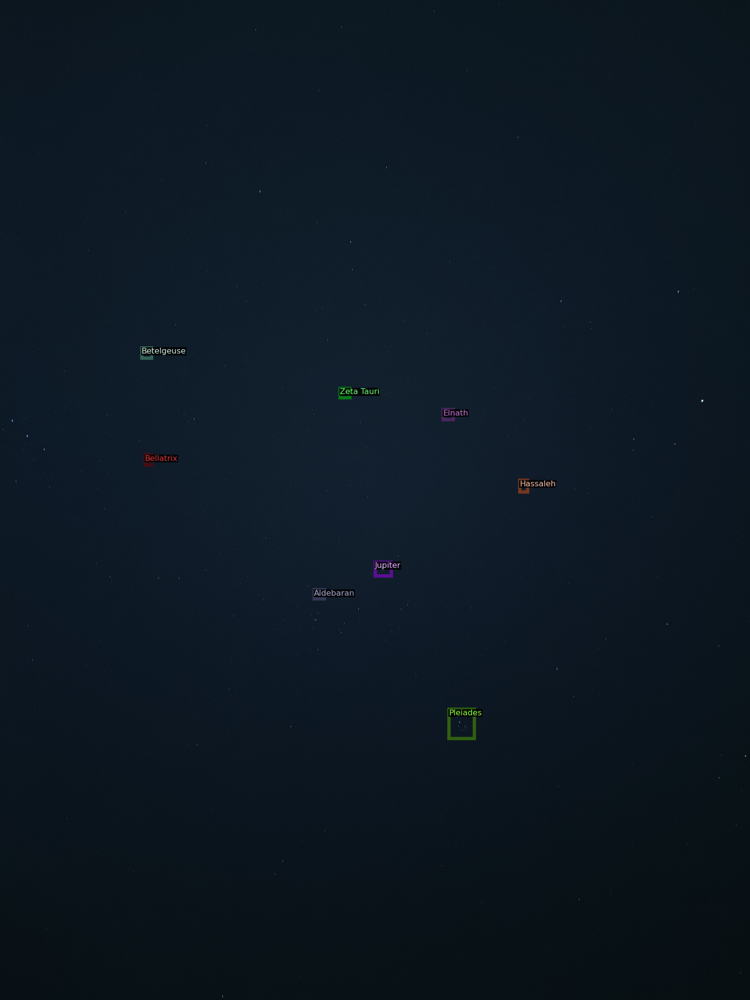

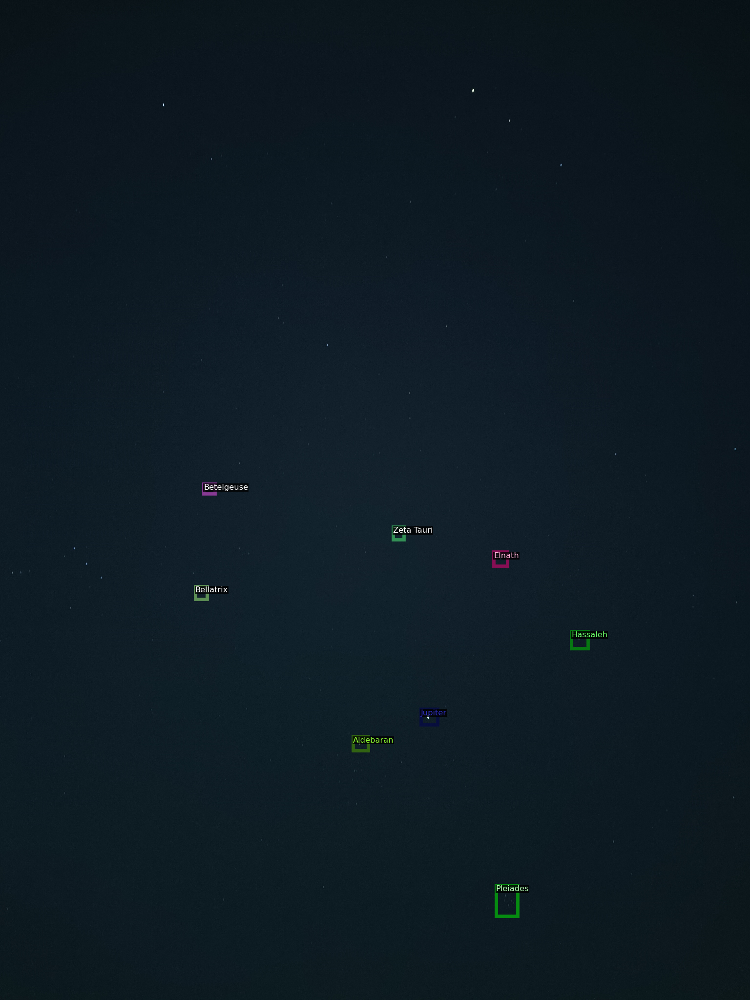

In [27]:
dataset_dicts = DatasetCatalog.get("mbtr1_train")  # Use registered dataset instead of get_balloon_dicts
mbtr1_metadata = MetadataCatalog.get("mbtr1_train")  # Get metadata

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])

    if img is None:
        print(f"⚠️ Error: Could not load image {d['file_name']}")
        continue

    visualizer = Visualizer(img[:, :, ::-1], metadata=mbtr1_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)

    cv2_imshow(out.get_image()[:, :, ::-1])  # Display image in Google Colab


## Train!

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the balloon dataset. It takes ~2 minutes to train 300 iterations on a P100 GPU.


In [29]:
from detectron2.data import MetadataCatalog

metadata = MetadataCatalog.get("mbtr1_train")  # Get registered metadata
print("✅ Classes in dataset:", metadata.thing_classes)
print("✅ Number of classes:", len(metadata.thing_classes))


✅ Classes in dataset: ['Pleiades', 'Jupiter', 'Betelgeuse', 'Aldebaran', 'Zeta Tauri', 'Elnath', 'Hassaleh', 'Bellatrix']
✅ Number of classes: 8


In [31]:
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("mbtr1_train",)
cfg.DATASETS.TEST = ()  # ✅ Add validation set for evaluation
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 300
cfg.SOLVER.STEPS = []
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 8  # ✅ Corrected to match your dataset

# Create output directory
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# Train the model
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

# ✅ Evaluate on test dataset after training
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator("mbtr1_test", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "mbtr1_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))


[02/28 23:28:05 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
  roi_heads.mask_head.mask_fcn1.{bias, weight}
  roi_heads.mask_head.mask_fcn2.{bias, weight}
  roi_heads.mask_head.mask_fcn3.{bias, weight}
  roi_heads.mask_head.mask_fcn4.{bias, weight}
  roi_heads.mask_head.deconv.{bias, weight}
  roi_heads.mask_head.predictor.{bias, weight}


[02/28 23:28:05 d2.engine.train_loop]: Starting training from iteration 0
[02/28 23:28:25 d2.utils.events]:  eta: 0:04:20  iter: 19  total_loss: 5.384  loss_cls: 2.304  loss_box_reg: 0.2903  loss_rpn_cls: 2.23  loss_rpn_loc: 0.5656    time: 0.9812  last_time: 1.0067  data_time: 0.5581  last_data_time: 0.5753   lr: 1.6068e-05  max_mem: 3616M
[02/28 23:28:45 d2.utils.events]:  eta: 0:04:01  iter: 39  total_loss: 2.77  loss_cls: 1.679  loss_box_reg: 0.7653  loss_rpn_cls: 0.05444  loss_rpn_loc: 0.3413    time: 0.9888  last_time: 0.8302  data_time: 0.5878  last_data_time: 0.4515   lr: 3.2718e-05  max_mem: 3616M
[02/28 23:29:05 d2.utils.events]:  eta: 0:03:44  iter: 59  total_loss: 2.157  loss_cls: 1.117  loss_box_reg: 0.786  loss_rpn_cls: 0.04787  loss_rpn_loc: 0.2297    time: 0.9822  last_time: 1.0835  data_time: 0.5770  last_data_time: 0.7051   lr: 4.9367e-05  max_mem: 3616M
[02/28 23:29:25 d2.utils.events]:  eta: 0:03:23  iter: 79  total_loss: 2.027  loss_cls: 0.9356  loss_box_reg: 0.802

In [32]:
# Look at training curves in tensorboard
%load_ext tensorboard
%tensorboard --logdir output
'!kill 5619'

<IPython.core.display.Javascript object>

'!kill 5619'

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [47]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.2  # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[02/28 23:57:59 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


/usr/local/lib/python3.11/dist-packages/fvcore/common/checkpoint.py:252: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  return torch.load(f, map_location=torch.device("cpu"))

Then, we randomly select several samples to visualize the prediction results.

[02/28 23:58:01 d2.data.datasets.coco]: Loaded 133 images in COCO format from /content/MBTr1/MBTr1/val/annotations.json
{'instances': Instances(num_instances=7, image_height=4096, image_width=3072, fields=[pred_boxes: Boxes(tensor([[1307.8005, 1238.8883, 1353.3234, 1297.2502],
        [1594.1927,  528.1241, 1638.3939,  582.0685],
        [2693.3586,  492.3792, 2740.6672,  550.1323],
        [ 174.3164,  208.7107,  219.1827,  268.6012],
        [2100.2224, 3079.3000, 2149.0244, 3134.9836],
        [1041.7560, 1378.0959, 1079.6462, 1418.8661],
        [1594.8008,  536.1678, 1629.4691,  574.6261]], device='cuda:0')), scores: tensor([0.3255, 0.2541, 0.2353, 0.2269, 0.2174, 0.2074, 0.2068],
       device='cuda:0'), pred_classes: tensor([1, 1, 1, 1, 1, 3, 5], device='cuda:0')])}


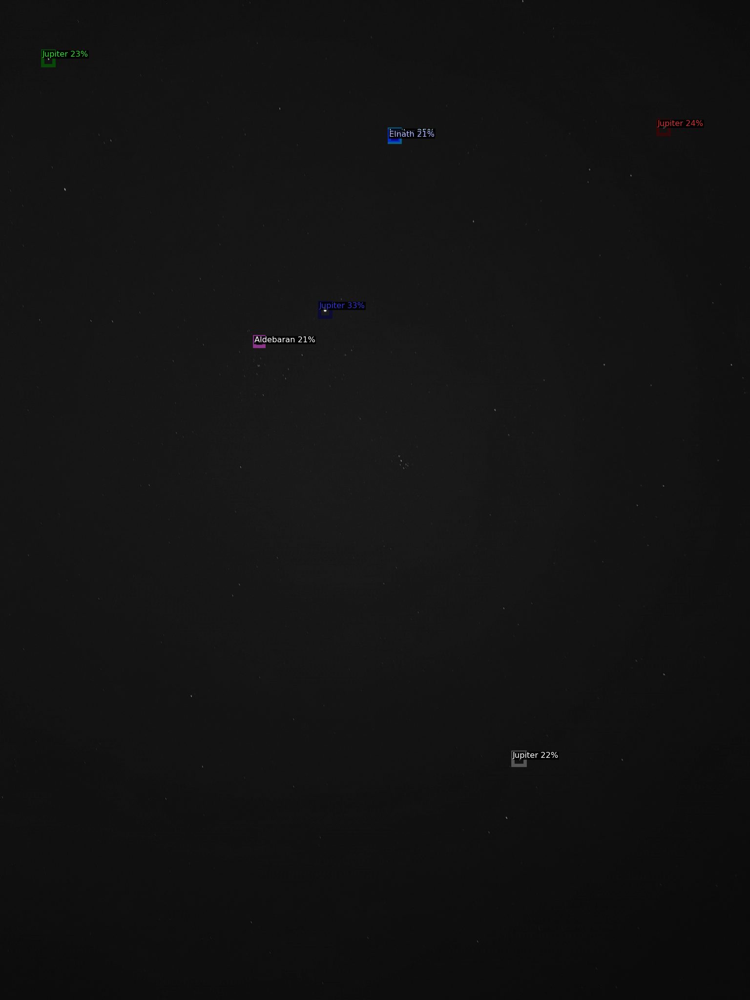

{'instances': Instances(num_instances=11, image_height=4096, image_width=3072, fields=[pred_boxes: Boxes(tensor([[1431.9009,  766.5665, 1473.7052,  818.0868],
        [1856.8912, 3242.9214, 1901.5713, 3298.1392],
        [ 733.1049, 2512.4131,  776.6583, 2561.6235],
        [ 237.6225, 1053.2108,  277.1993, 1102.0363],
        [1424.2888,  761.4484, 1460.0060,  813.7128],
        [1872.0420, 3245.0520, 1914.4822, 3292.3262],
        [1858.4911, 3250.3140, 1894.8560, 3290.3838],
        [1589.1051,  818.6567, 1629.4249,  872.1362],
        [ 738.2625, 2518.7502,  772.6317, 2555.0601],
        [1989.5573, 2508.4500, 2020.7456, 2545.0830],
        [1602.2974, 3434.2620, 1638.5592, 3479.9265]], device='cuda:0')), scores: tensor([0.3568, 0.3308, 0.2936, 0.2734, 0.2315, 0.2133, 0.2119, 0.2114, 0.2041,
        0.2011, 0.2007], device='cuda:0'), pred_classes: tensor([1, 1, 1, 1, 1, 1, 5, 1, 5, 5, 3], device='cuda:0')])}


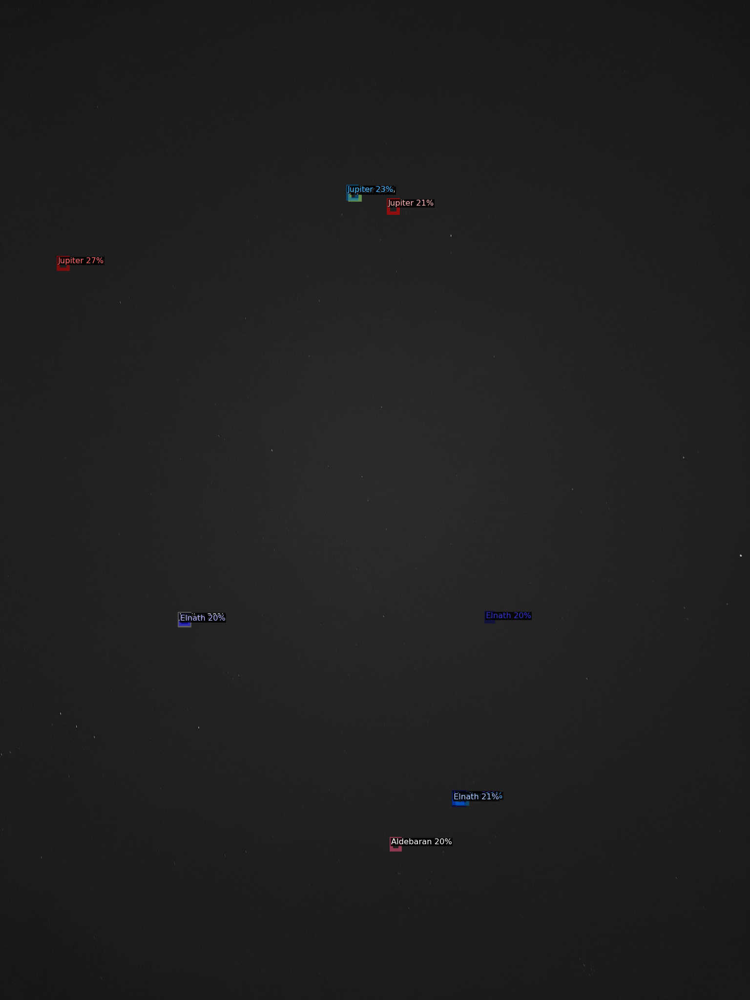

{'instances': Instances(num_instances=7, image_height=4096, image_width=3072, fields=[pred_boxes: Boxes(tensor([[1405.8920, 2678.7366, 1450.3073, 2738.5337],
        [ 267.0643, 1987.5150,  308.9050, 2038.4503],
        [2509.2905, 1767.1296, 2557.9185, 1816.4818],
        [1548.3534, 1995.3463, 1589.0020, 2042.2231],
        [1156.4550, 2858.5039, 1192.9176, 2901.3992],
        [1549.7211, 1991.5570, 1590.7944, 2035.4441],
        [ 269.5693, 1990.6893,  304.6248, 2029.5314]], device='cuda:0')), scores: tensor([0.3256, 0.2545, 0.2423, 0.2110, 0.2101, 0.2076, 0.2003],
       device='cuda:0'), pred_classes: tensor([1, 1, 1, 1, 3, 5, 5], device='cuda:0')])}


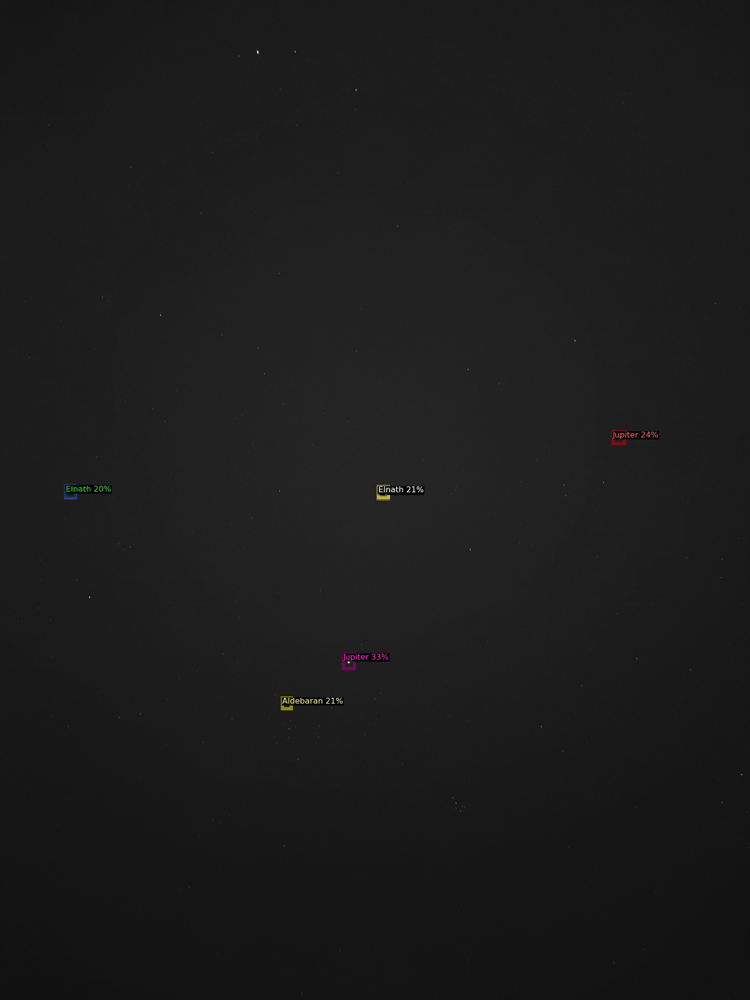

In [48]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = DatasetCatalog.get("mbtr1_val")  # ✅ Corrected
mbtr1_metadata = MetadataCatalog.get("mbtr1_val")  # ✅ Get correct metadata
for d in random.sample(dataset_dicts, 3):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=mbtr1_metadata,
                   scale=0.5,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    # Run inference

    cv2_imshow(out.get_image()[:, :, ::-1])

We can also evaluate its performance using AP metric implemented in COCO API.
This gives an AP of ~70. Not bad!

In [37]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

# ✅ Use "mbtr1_val" instead of "balloon_val"
evaluator = COCOEvaluator("mbtr1_val", output_dir="./output")

# ✅ Use the correct dataset configuration for validation
val_loader = build_detection_test_loader(cfg, "mbtr1_val")

# ✅ Run evaluation
print(inference_on_dataset(predictor.model, val_loader, evaluator))

# Another way to evaluate:
# trainer.test(cfg, trainer.model)


[02/28 23:51:44 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
[02/28 23:51:44 d2.data.datasets.coco]: Loaded 133 images in COCO format from /content/MBTr1/MBTr1/val/annotations.json
[02/28 23:51:44 d2.data.build]: Distribution of instances among all 8 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|  Pleiades  | 132          |  Jupiter   | 133          | Betelgeuse | 121          |
| Aldebaran  | 133          | Zeta Tauri | 126          |   Elnath   | 127          |
|  Hassaleh  | 139          | Bellatrix  | 126          |            |              |
|   total    | 1037         |            |              |            |              |
[02/28 23:51:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='

[03/01 00:03:56 d2.data.datasets.coco]: Loaded 134 images in COCO format from /content/MBTr1/MBTr1/test/annotations.json


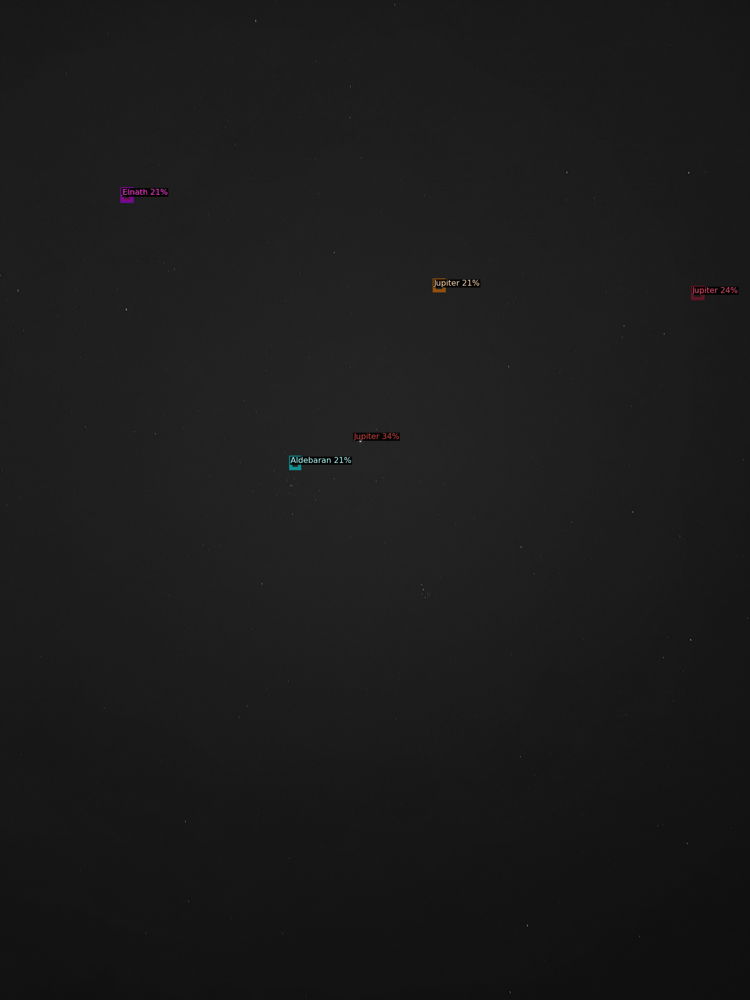

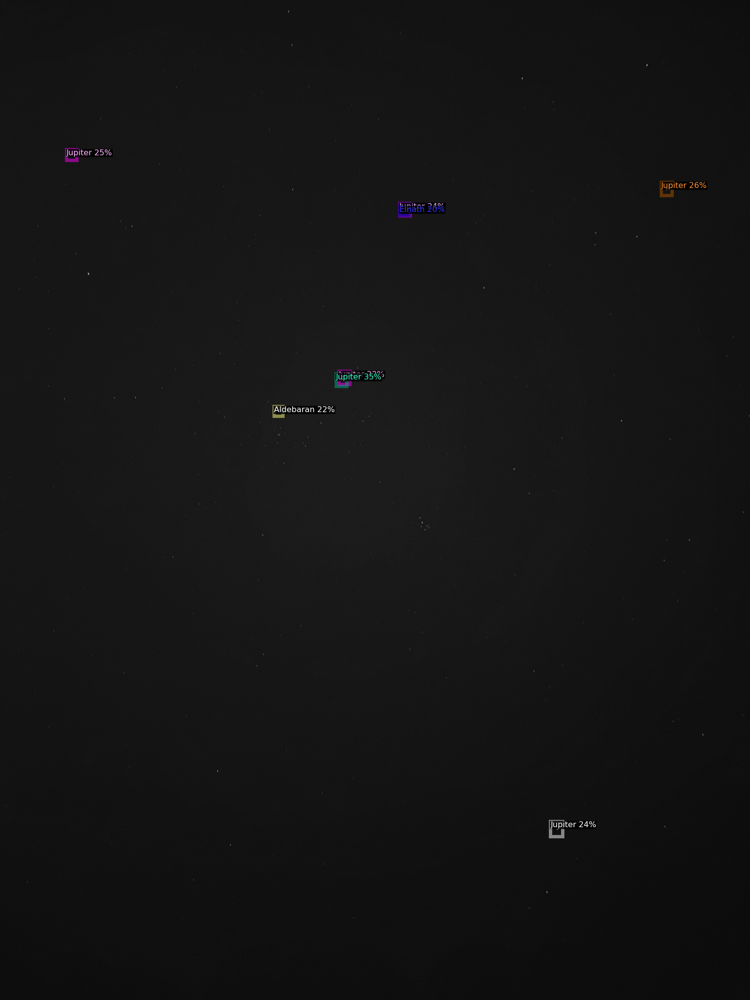

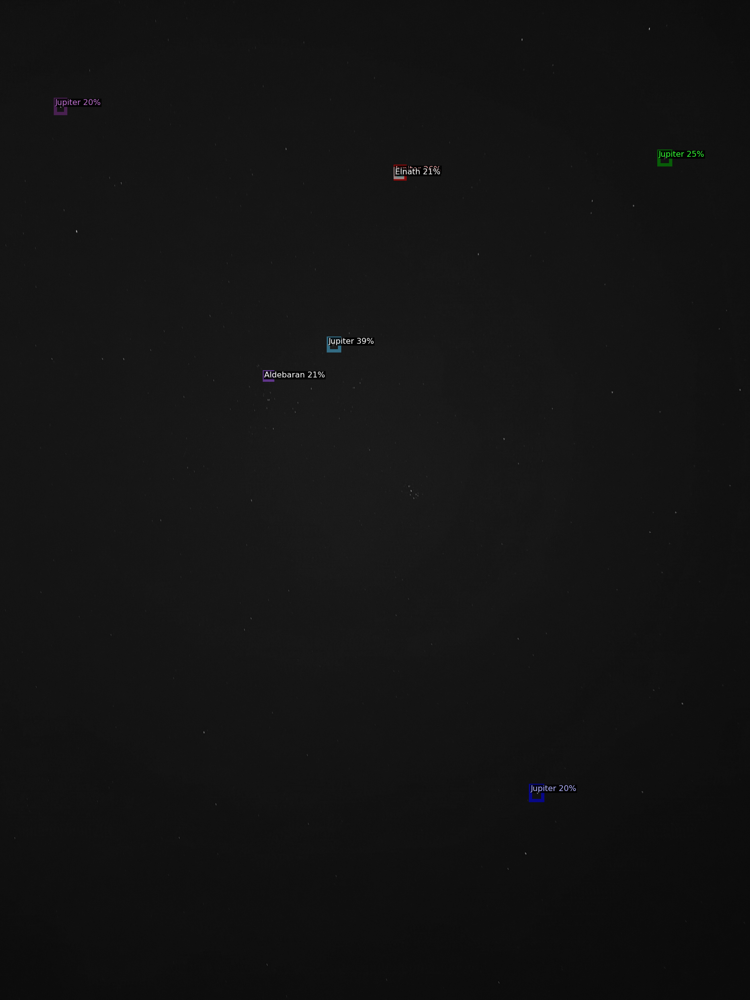

In [49]:
import random
import cv2
from detectron2.utils.visualizer import Visualizer, ColorMode
from google.colab.patches import cv2_imshow  # Use for Google Colab

# ✅ Load test dataset
dataset_dicts = DatasetCatalog.get("mbtr1_test")
mbtr1_metadata = MetadataCatalog.get("mbtr1_test")

# ✅ Select random test images
for d in random.sample(dataset_dicts, 3):
    im = cv2.imread(d["file_name"])

    if im is None:
        print(f"⚠️ Error: Could not load image {d['file_name']}")
        continue

    # ✅ Run inference
    outputs = predictor(im)

    # ✅ Visualize results
    v = Visualizer(im[:, :, ::-1], metadata=mbtr1_metadata, scale=0.5, instance_mode=ColorMode.IMAGE_BW)
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))

    # ✅ Display image
    cv2_imshow(out.get_image()[:, :, ::-1])
